**Install dependencies**

In [ ]:
# !pip install -U beautifulsoup4 cloudscraper pandas pillow
# !pip install -U cjm_pil_utils cjm_parallel_utils

**Import dependencies**

In [ ]:
import random
from pathlib import Path
from PIL import Image
from functools import partial
from io import BytesIO

from bs4 import BeautifulSoup
import cloudscraper

import pandas as pd
pd.set_option('max_colwidth', None)  # Do not truncate the contents of cells in the DataFrame
pd.set_option('display.max_rows', None)  # Display all rows in the DataFrame
pd.set_option('display.max_columns', None)  # Display all columns in the DataFrame

In [ ]:
from cjm_pil_utils.core import get_img_files, resize_img
from cjm_parallel_utils.core import parallel

**Define path to image attribute data**

In [ ]:
# Set the file path for the attributes dataframe
attributes_df_json_file = '/mnt/980_1TB_2/Datasets/pexels-110k-768p-min-jpg/attributes_df.json'

# Print the file path
print(attributes_df_json_file)

/mnt/980_1TB_2/Datasets/pexels-110k-768p-min-jpg/attributes_df.json


**Import image attributes**

In [ ]:
# Read the attributes dataframe from the JSON file
attributes_df = pd.read_json(attributes_df_json_file)

# Print the number of entries in the dataframe
print(f"Number of entries: {len(attributes_df)}")

# Display the first few rows of the dataframe
attributes_df.head().transpose()

Number of entries: 109971


,3186010,3185509,3182800,3184308,3185747
title,Pink and White Ice Cream Neon Signage,Garnishing of Syrup on a Cheesecake,People in Front of the Computers,Photo Of People Next To Each Other,Aerial View of Coconut Trees at Rural Area
aspect_ratio,0.749809,1.0,1.498501,1.5,1.499795
main_color,"[128, 38, 77]","[185, 167, 164]","[176, 175, 169]","[201, 179, 150]","[154, 139, 128]"
colors,"[#000000, #a52a2a, #bc8f8f, #c71585, #d02090, #d8bfd8]","[#000000, #696969, #bc8f8f, #cd5c5c, #d3d3d3]","[#000000, #696969, #a9a9a9, #add8e6, #f5f5f5]","[#708090, #a0522d, #cd853f, #eedd82, #ffdab9]","[#696969, #808080]"
tags,"[bright, chocolate, close-up, cold, cream, creamy, cup, dairy product, delicious, design, dessert, electricity, epicure, flavors, fluorescent, food, food photography, goody, hand, ice cream, icecream, illuminated, indulgence, light pink background, neon, neon lights, neon sign, pastry, pink background, pink wallpaper, scoop, sweet, sweets, tasty]","[cheesecake, dessert, epicure, food photography, food plating, food porn, food preparation, food styling, garnishing, gastronomy, glaze, syrup]","[colleagues, computer, connection, cooperation, desk, dreadlocks, employees, facial expression, furniture, indoors, internet, looking, office, people, room, sit, sitting, table, teamwork, technology, women, work, working, workplace]","[adults, casual, communication, conversation, fashion, fashionable, fun, gather, gathered, gathering, happiness, happy, leisure, outfit, recreation, sit, sitting, smile, smiling, style, stylish, wear]","[aerial shot, coconut trees, daylight, drone shot, exotic, high angle shot, outdoors, palm trees, sand, summer, trees, tropical]"
adult,very_unlikely,very_unlikely,unlikely,unlikely,None
aperture,1.8,NaN,NaN,NaN,2.6
camera,iPhone X,,None,None,FC1102
focal_length,4.0,NaN,NaN,NaN,4.49
google_place_id,ChIJkUjxJ7it1y0R4qOVTbWHlR4,None,None,None,None


**Get unique tags**

In [ ]:
# Extract the unique tags from the DataFrame and convert them to a list
tags = attributes_df['tags'].explode().unique().tolist()

# Print the number of unique tags
print(f"Unique Tags: {len(tags)}")

# Display the first few tags using a DataFrame
pd.DataFrame(tags).head()

Unique Tags: 21191


,0
0,bright
1,chocolate
2,close-up
3,cold
4,cream


**Select a tag**

In [ ]:
# Choose a random tag from the list of tags
# tag_term = random.choice(tags)

# Manually choose a tag
tag_term = 'golden hour'

# Print the chosen tag
tag_term

'golden hour'

**Search dataset for a specific tag**

In [ ]:
# Create a mask for the attributes_df dataframe to identify rows where the 'tags' column contains the search term
mask = attributes_df.tags.apply(lambda x: tag_term in x if x is not None else False)

# Create a new dataframe containing only the rows that match the mask
results_df = attributes_df[mask]

# Print the number of rows in the resulting dataframe
print(f"Found {len(results_df)} entries")

# Display the first few rows of the resulting dataframe
results_df.head().transpose()

Found 1293 entries


,3157917,3150702,3157967,3170887,3163677
title,Photo Of Sunset During Dawn,Aerial Photography of City Buildings During Golden Hour,Calm Sea During Golden Hour,Photo of Trees During Golden Hour,Photo Of People In Front Of Mosque During Golden Hour
aspect_ratio,1.333234,0.669421,1.5,0.666667,1.509804
main_color,"[152, 118, 96]","[137, 102, 94]","[119, 107, 97]","[142, 140, 132]","[189, 145, 91]"
colors,"[#000000, #deb887, #e9967a]","[#000000, #696969, #ff7f50, #ffa07a]","[#000000, #faebd7]","[#000000, #dcdcdc]","[#8b4513, #deb887, #faebd7]"
tags,"[afterglow, calm, dawn, dusk, environment, golden hour, horizon, idyllic, nature, nature photography, ocean, peaceful, ripples, scenery, scenic, sea, seascape, sun, sunbeam, sunrise, sunset, tranquil]","[city, dawn, dusk, fog, foggy, golden hour, hills, morning, scenery, scenic, silhouette, sky, sunrise, sunset, urban, view]","[clouds, dawn, dusk, golden hour, horizon, islands, ocean, outdoors, rock formation, sea, seashore, shore, sky, sunrise, sunset, travel, water]","[dawn, dusk, environment, forest, golden hour, horizon, nature, outdoors, scenery, trees, woods]","[arches, architectural building, architectural design, architectural detail, architecture, belief, blue mosque, building, celebration, crowd, crowded, culture, dawn, daylight, delhi, domes, dusk, eid, exterior, faith, gathering, golden hour, grand mosque, historic, historical building, house of worship, islam, islamic architecture, jama, landmark, masjid, minarets, monument, mosque, muslim, muslims, outdoors, people, pillars, prayers, praying, ramadan, religion, religious, sacred, salah, sheikh zayed mosque, spirituality, square, sultan ahmed mosque, sun, sunbeam, sunlight, sunrays, sunrise, sunset, sunshine, temple, towers, tradition, traditional, travel, trust, turning point, worship]"
adult,very_unlikely,very_unlikely,very_unlikely,None,very_unlikely
aperture,1.7,5.6,7.1,1.8,11.0
camera,ONEPLUS A6013,NIKON D3000,Canon EOS 6D,Canon EOS Kiss X7,NIKON D7000
focal_length,4.25,70.0,30.0,50.0,18.0
google_place_id,ChIJCxgesixFDhMR0oAyeQNvqig,None,None,None,None


**Get image IDs from search results**

In [ ]:
# Retrieve a list of the image IDs for the entries in the results_df dataframe
results_df_img_ids = results_df.index.to_list()

# Print the first image ID in the list
print(results_df_img_ids[0])

3157917


**Select an image ID**

In [ ]:
# Choose a random image ID from the list of image IDs in the results_df dataframe
results_img_id = random.choice(results_df_img_ids)

# Print the chosen image ID
print(results_img_id)

2879990


**Define scraper object**

In [ ]:
# Create an instance of a CloudScraper object
scraper = cloudscraper.create_scraper()

**Define function to download an image from Pexels**

In [ ]:
def download_img(img_id, scraper):
    # Define the URL to download the image with the specified image ID
    url = f"https://www.pexels.com/photo/{img_id}/download/"

    # Use the scraper to make a GET request to the URL
    page_resp = scraper.get(url)
    
    try:
        # Attempt to open the downloaded content as an image using the BytesIO class
        dl_img = Image.open(BytesIO(page_resp.content))
        
        # If the image was successfully opened, return it.
        return dl_img
    except:
         # If an error occurred while trying to open the image, print a message and return `None`.
        return None    

**Download selected image**

In [ ]:
# Download the image with the specified image ID
dl_img = download_img(results_img_id, scraper)

**Display the downloaded image**

Title: Wide Angle Photography of Green Trees
Dimensions: (3648, 4560)


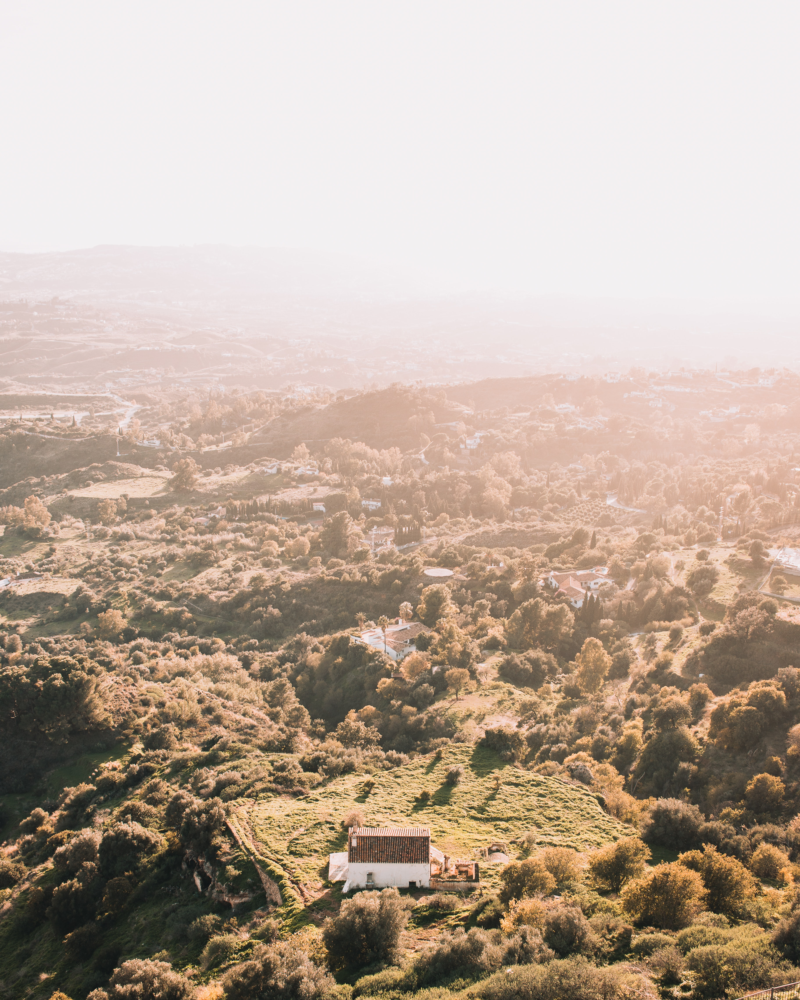

In [ ]:
# Print the title of the image, located in the 'title' column of the attributes_df dataframe
print(f"Title: {attributes_df.loc[results_img_id]['title']}")

# Print the dimensions of the downloaded image
print(f"Dimensions: {dl_img.size}")

# Display the downloaded image
dl_img

**Resize the downloaded image**

New Dimensions: (512, 640)


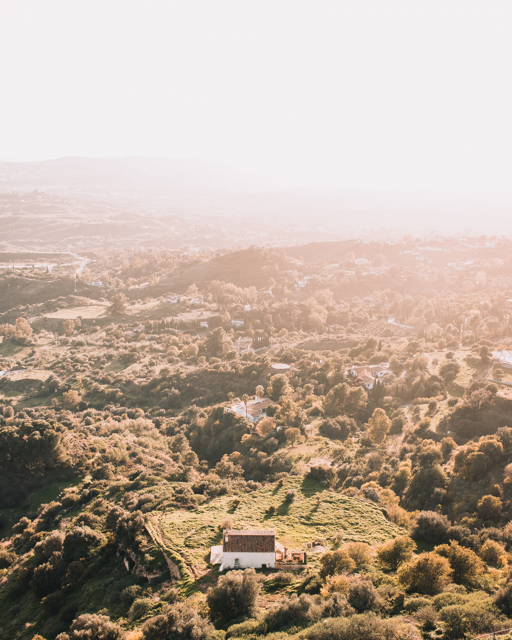

In [ ]:
# Resize the image while maintaining the aspect ratio
resized_img = resize_img(dl_img, target_sz=512)

# Print the dimensions of the resized image
print(f"New Dimensions: {resized_img.size}")

# Display the resized image
resized_img

**Define function to apply to an array of image IDs**

In [ ]:
def array_func(img_id, scraper, save_dir, target_sz=512, divisor=32, img_fmt='JPEG', quality=100):
    """
    This function downloads an image from the Pexels website using a given `img_id` and `scraper` object, 
    resizes the image to a specified size using the `resize_img` function, and saves the resized image 
    to a specified directory.
    """
    # Download the image from the Pexels website using the given `img_id` and `scraper` object.
    dl_img = download_img(img_id, scraper)
    
    # If the download failed, skip the rest of the function.
    if dl_img is None: return
    
    # Resize the image using the `resize_img` function.
    resized_img = resize_img(dl_img, target_sz=target_sz, divisor=divisor)
    
    # Construct the path where the resized image should be saved.
    save_path = Path(save_dir/f"{img_id}.{img_fmt.lower()}")
    
    # Save the resized image to the specified directory using the specified image format and quality settings.
    resized_img.save(save_path, img_fmt, quality=quality)

**Define save directory**

In [ ]:
Path(attributes_df_json_file).parent.parent

PosixPath('/mnt/980_1TB_2/Datasets')

In [ ]:
# Create a `Path` object for the directory that will be used to save the images.
save_dir = Path(Path(attributes_df_json_file).parent.parent/f"pexels_{tag_term.replace(' ', '-')}")

# Create the directory if it does not already exist.
save_dir.mkdir(parents=True, exist_ok=True)

# Print the `Path` object for the save directory.
save_dir

PosixPath('/mnt/980_1TB_2/Datasets/pexels_golden-hour')

**Test array function**

In [ ]:
# Use the `array_func` function to download and save the first image in the `results_df_img_ids` list.
array_func(results_df_img_ids[0], scraper, save_dir)

# Use the `get_img_files` function to get a list of paths to the images that were saved in the specified directory.
dl_img_paths = get_img_files(save_dir)

# Display the paths of the saved images using a Pandas DataFrame.
pd.DataFrame(list(dl_img_paths))

,0
0,/mnt/980_1TB_2/Datasets/pexels_golden-hour/3157917.jpeg


**View downloaded image**

Title: Photo Of Sunset During Dawn


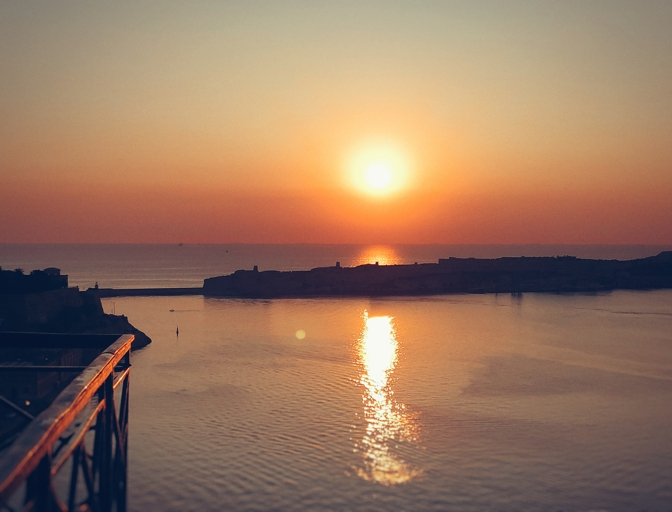

In [ ]:
# Get the the path to the downloaded image
dl_img_path = dl_img_paths[0]

# Open the downloaded image
dl_img = Image.open(dl_img_path)

# Print the title of the image, located in the 'title' column of the attributes_df dataframe
print(f"Title: {attributes_df.loc[int(dl_img_path.stem)]['title']}")

# Display the downloaed image
dl_img

**Download images in parallel**

In [ ]:
# Set the target size for the images that will be downloaded.
target_sz = 512

# Create a partial function that has the `scraper`, `save_dir`, and `target_sz` parameters already set.
partial_func = partial(array_func, scraper=scraper, save_dir=save_dir, target_sz=target_sz)

# Use the `parallel` function to download and save the images in the `results_df_img_ids` list in parallel.
parallel(func=partial_func, arr=results_df_img_ids)

**Get downloaded image paths**

In [ ]:
# Use the `get_img_files` function to get a list of paths to the images that were saved in the specified directory.
dl_img_paths = get_img_files(save_dir)

# Print the number of images that were downloaded.
print(f"Downloaded Images: {len(dl_img_paths)}")

# Create a DataFrame containing the paths of the saved images and display the first few rows of the DataFrame.
pd.DataFrame(list(dl_img_paths)).head()

Downloaded Images: 499


,0
0,/mnt/980_1TB_2/Datasets/pexels_golden-hour/1354285.jpeg
1,/mnt/980_1TB_2/Datasets/pexels_golden-hour/1643758.jpeg
2,/mnt/980_1TB_2/Datasets/pexels_golden-hour/1738675.jpeg
3,/mnt/980_1TB_2/Datasets/pexels_golden-hour/1885793.jpeg
4,/mnt/980_1TB_2/Datasets/pexels_golden-hour/1885795.jpeg
